# Curso FIC - Aula 03 - Modelos e regressão linear

27/09/2021 

Piracicaba - SP

Gustavo Voltani von Atzingen

## Tópicos

Modelos e regressão linear - base do aprendizado de máquina
Core de muitos modelos
Simples
Tem os conceitos mais importante utilizados nos alg. mais complexos.
Pode ser muito poderoso (com boa extração de features)

* Pandas e visualizaçao de datasets

* Modelo linear 1 variável (peso x altura)

* Função custo

* Encontrar o mínimo

* Gradiente descendente

* Mínimos quadrados

* Multi-variável
    (preço de casas)

* Modelos polinomiais - overfit

In [1]:
import sys, os, time
from tqdm import tqdm

import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

from sklearn import linear_model
from sklearn.model_selection import train_test_split
from sklearn.datasets import fetch_california_housing, fetch_openml
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

from ipywidgets import interact, interactive, fixed, interact_manual
import ipywidgets as widgets
pd.options.plotting.backend = "plotly"

## Modelo Linear - Peso vs Altura

Faça o download e extraia o arquivo weight-height.csv para a mesma pasta deste notebook

https://www.kaggle.com/mustafaali96/weight-height/download

In [133]:
df = pd.read_csv('weight-height.csv')
df['Height'] = df['Height']*0.0254
df['Weight'] = df['Weight']*0.453592

## Visualização dos dados 

* Pandas 
* Plotly
* Numpy

In [46]:
df.head(3)

,Gender,Height,Weight
0,Male,1.875714,109.720985
1,Male,1.747060,73.622732
2,Male,1.882397,96.497550


In [47]:
df.tail(3)

,Gender,Height,Weight
9997,Female,1.622247,58.275377
9998,Female,1.753470,74.322166
9999,Female,1.573384,51.550324


In [134]:
df.corr()

,Height,Weight
Height,1.000000,0.924756
Weight,0.924756,1.000000


In [48]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Height,10000.0,1.685736,0.097727,1.378284,1.613043,1.684479,1.757026,2.006568
Weight,10000.0,73.228054,14.564131,29.347460,61.605982,73.124894,84.898599,122.465167


In [53]:
df.query('Gender == "Female" and Height < 1.6')

,Gender,Height,Weight
5000,Female,1.496333,46.306448
5004,Female,1.569545,58.867808
5006,Female,1.596400,52.149036
5008,Female,1.572012,50.655431
5011,Female,1.569692,48.186751
...,...,...,...
9991,Female,1.590972,46.653553
9992,Female,1.576777,62.909437
9993,Female,1.524773,44.310238
9994,Female,1.501096,50.135381


In [54]:
df[df.Gender == "Male"]

,Gender,Height,Weight
0,Male,1.875714,109.720985
1,Male,1.747060,73.622732
2,Male,1.882397,96.497550
3,Male,1.821967,99.809504
4,Male,1.774998,93.598619
...,...,...,...
4995,Male,1.749046,80.345228
4996,Male,1.751925,72.250505
4997,Male,1.702150,90.353440
4998,Male,1.817566,84.325433


In [56]:
df.iloc[0:5]

,Gender,Height,Weight
0,Male,1.875714,109.720985
1,Male,1.747060,73.622732
2,Male,1.882397,96.497550
3,Male,1.821967,99.809504
4,Male,1.774998,93.598619


In [57]:
df.corr()

,Height,Weight
Height,1.000000,0.924756
Weight,0.924756,1.000000


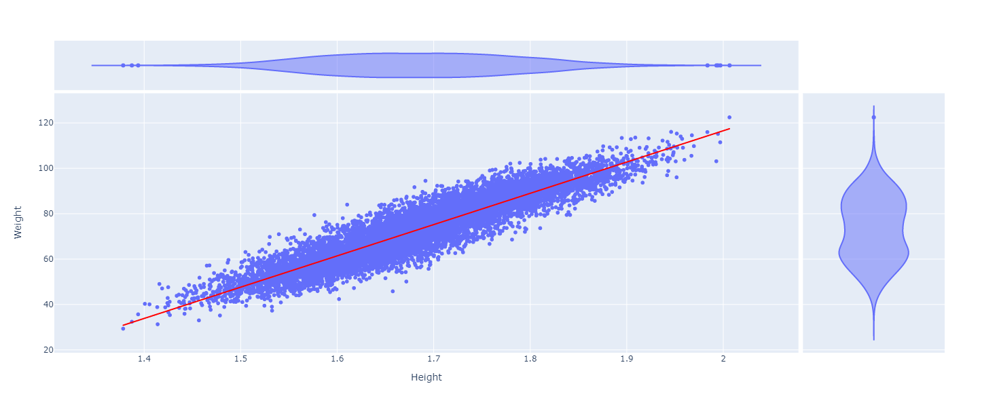

In [72]:
px.scatter(df, x="Height", y="Weight", height=600, marginal_x="violin", marginal_y="violin", trendline="ols", trendline_color_override="red")

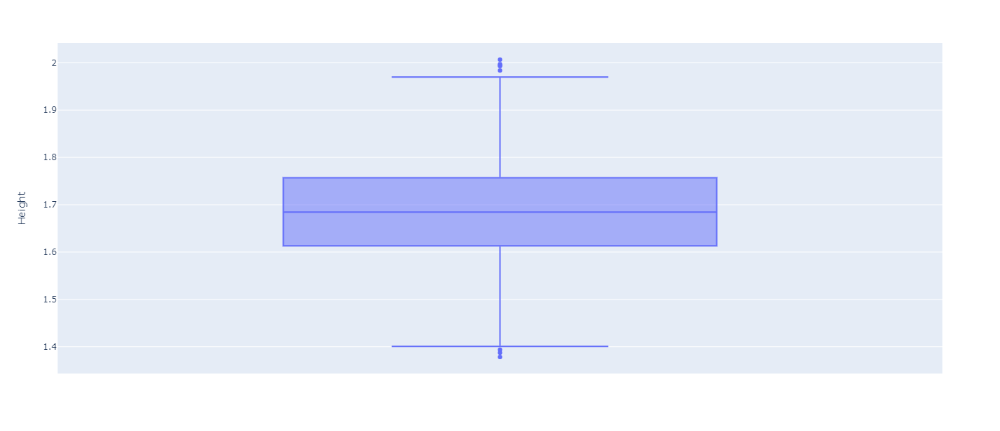

In [61]:
px.box(df, y="Height", height=600)

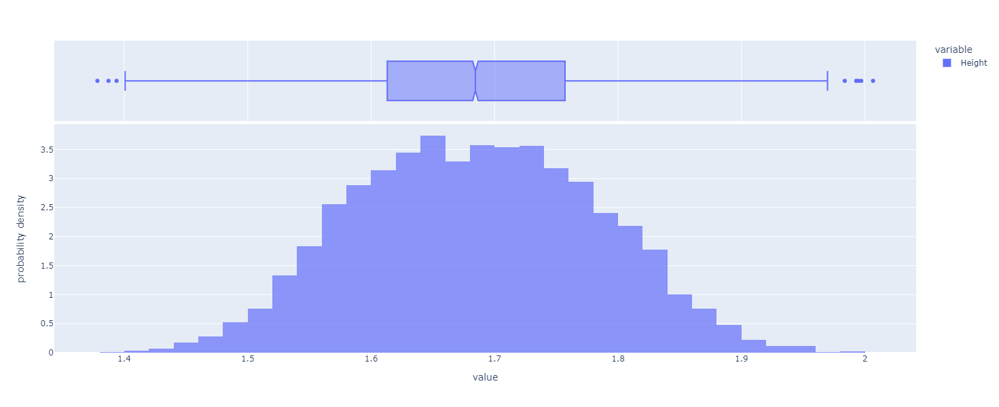

In [68]:
px.histogram(df["Height"], nbins=50, opacity=0.7, height=600, histnorm='probability density', marginal='box')

## Modelo linear

Premissa: Existe uma correlação entre o peso e a altura.

Objetivo: Encontrar o melhor valor de A e B pra uma equação que relacione o peso e a altura:

<p>&nbsp;</p>

$ \Large y(x) = A + B \cdot x $

<p>&nbsp;</p>

$ \Large P(h) = A + B \cdot h $

Onde: 
* h = Altura
* P(h) = Peso calculado para uma altura conhecida 
* A e B - Parâmetros da equação linear (kg)

## Função Custo

A função custo é definida por:

$$ \Large J = \frac{1}{n} \cdot \sum_{i=1}^{n}(pred_i - y_i)^2 $$

Lembrando que:

* $ \Large  y_i $ é o i-ésimo resultado (dado) do nosso dataset - no nosso caso: peso.

* $ \Large pred_i $ é o resultado predito para o i-éismo dado - no nosso caso o resultado da altura

In [73]:
peso = df.Weight.to_numpy()
altura = df.Height.to_numpy()
print(peso.shape, altura.shape)

(10000,) (10000,)


In [76]:
def custo(A, B):
    pred = A + B*altura
    n = altura.shape[0]
    J = (1/n)*((pred - peso)**2).sum()
    return J

In [83]:
custo(-159, 137)

32.36692307089068

In [86]:
def plot_guess(A, B):
    J = custo(A, B)
    linha_x = np.linspace(altura.min(), altura.max())
    linha_y = A + linha_x*B
    fig = px.scatter(df, x='Height', y='Weight', title=f'Custo: {J}', height=600)
    fig.add_trace(go.Scatter(
        x=linha_x,
        y=linha_y,
        mode="lines",
        line=go.scatter.Line(color="red"),
        showlegend=False))
    fig.data = (fig.data[0],fig.data[1])
    fig.show()

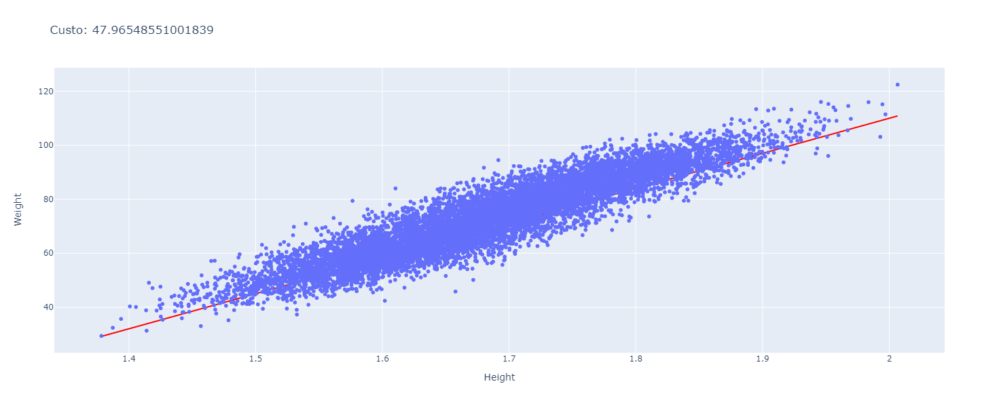

In [89]:
plot_guess(-150, 130)

In [90]:
interact(plot_guess, A=widgets.IntSlider(min=-200, max=200, step=1, value=0), B=widgets.IntSlider(min=-200, max=200, step=1, value=0, continuous_update=False))

interactive(children=(IntSlider(value=0, description='A', max=200, min=-200), IntSlider(value=0, continuous_up…

<function __main__.plot_guess(A, B)>

## Problema de Otimização: Como encontrar o melhor A e B ?

* Mínimos quadrados

* Força Bruta

* Gradiente descendente

### Mínimos Quadrados:


Supondo: $$ \Large y(x) = A + B \cdot x $$

<p>&nbsp;</p>

Temos: $$ \Large B = \frac{n \sum x_i y_i - \sum x_i \cdot \sum y_i}{n \sum x_i^2 - (\sum x_i)^2} $$

<p>&nbsp;</p>

$$ \Large A = \frac{\sum y_i - B \sum x_i}{n} $$

In [93]:
n = altura.shape[0]

B = (n*(altura*peso).sum() - altura.sum()*peso.sum())/(n*(altura**2).sum() - (altura.sum())**2)
A = (peso.sum() - B*altura.sum())/n

In [94]:
print(A, B)

-159.0915843084251 137.81495809286375


In [97]:
lin_reg = LinearRegression().fit(altura.reshape(-1, 1), peso)

In [98]:
lin_reg.coef_

array([137.81495809])

In [99]:
lin_reg.intercept_

-159.09158430845082

### Força Bruta

A -> -100, -200 - 500 valores

B -> 100, 200 - 500 valores

In [107]:
n_grade = 500
A_varredura = np.linspace(-100, -200, n_grade)
B_varredura = np.linspace(100, 200, n_grade)

In [108]:
grade_erro = np.ndarray((n_grade, n_grade))

In [113]:
for i, a in enumerate(tqdm(A_varredura)):
    for j, b in enumerate(B_varredura):
        grade_erro[i, j] = custo(a, b)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:06<00:00, 80.56it/s]


In [114]:
grade_erro.min()

30.717309369909746

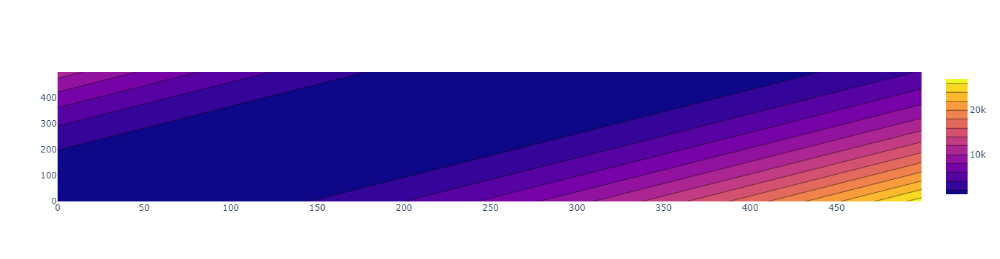

In [115]:
fig = go.Figure(data=go.Contour(z=grade_erro))
fig.show()

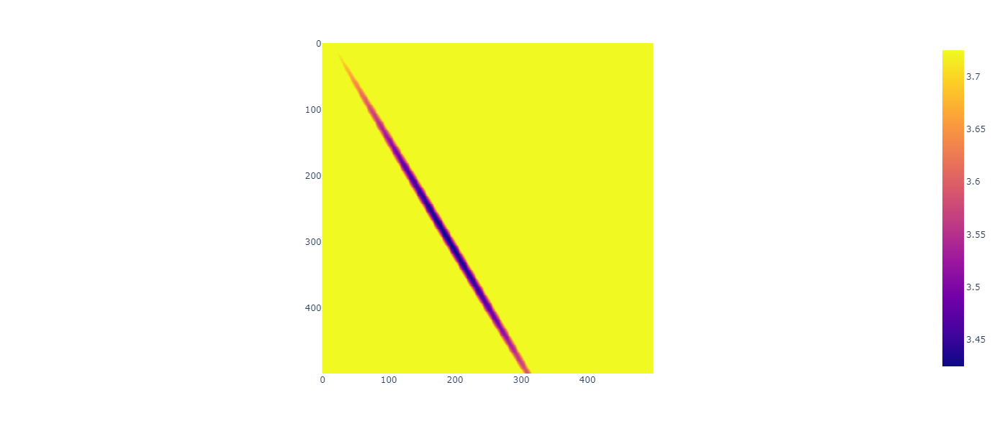

In [117]:
px.imshow(np.log(grade_erro), zmin=np.log(grade_erro.min()), zmax=np.log(grade_erro.min()*1.35), height=600)

### Gradiente Descendente

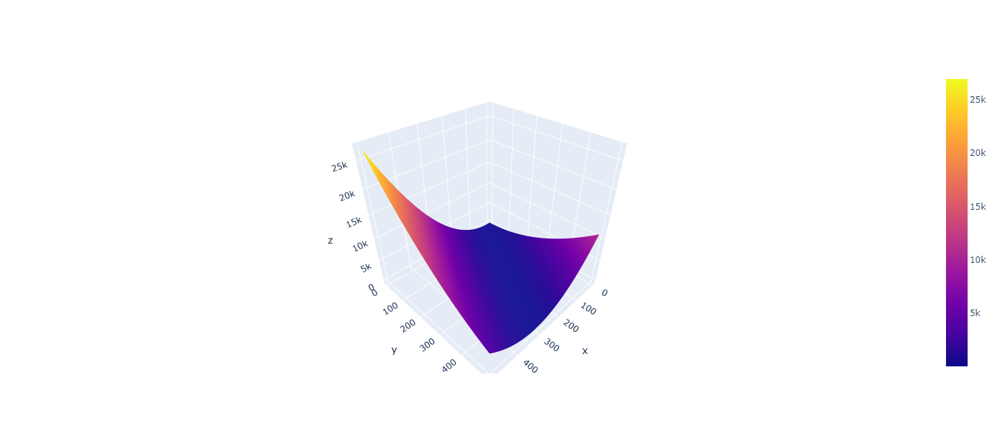

In [118]:
fig = go.Figure(data=[go.Surface(z=grade_erro)])
fig.update_layout(height=600)
fig.show()

## House Prices

In [119]:
housing = fetch_california_housing()
# housing = fetch_openml(name="house_prices", as_frame=True) 

In [121]:
print(housing['DESCR'])

.. _california_housing_dataset:

California Housing dataset
--------------------------

**Data Set Characteristics:**

    :Number of Instances: 20640

    :Number of Attributes: 8 numeric, predictive attributes and the target

    :Attribute Information:
        - MedInc        median income in block
        - HouseAge      median house age in block
        - AveRooms      average number of rooms
        - AveBedrms     average number of bedrooms
        - Population    block population
        - AveOccup      average house occupancy
        - Latitude      house block latitude
        - Longitude     house block longitude

    :Missing Attribute Values: None

This dataset was obtained from the StatLib repository.
http://lib.stat.cmu.edu/datasets/

The target variable is the median house value for California districts.

This dataset was derived from the 1990 U.S. census, using one row per census
block group. A block group is the smallest geographical unit for which the U.S.
Census Bur

In [135]:
df = pd.DataFrame(data=housing['data'], columns=housing['feature_names'])
df['PRECO'] = housing['target']

In [136]:
df.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,PRECO
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422


In [137]:
cor = df.corr().round(2)

<AxesSubplot:>

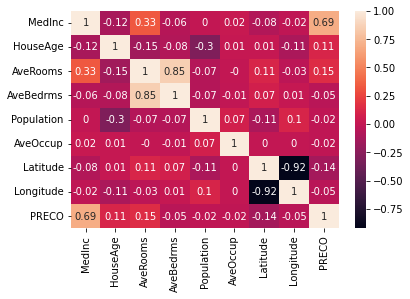

In [139]:
sns.heatmap(data=cor, annot=True)

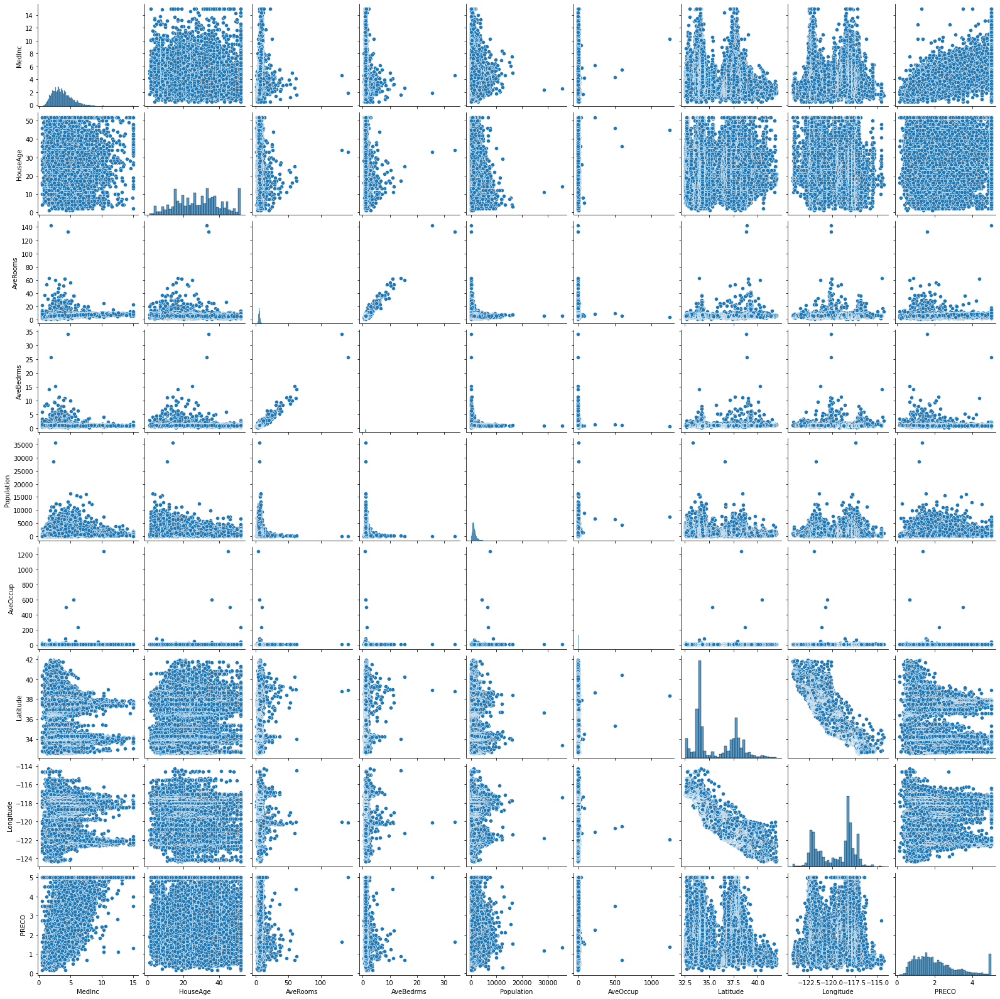

In [140]:
sns.pairplot(df)

In [124]:
lin_model = LinearRegression()

In [125]:
X = pd.DataFrame(np.c_[df['MedInc'], df['HouseAge'], df['AveRooms'], df['Latitude']], columns = ['MedInc','HouseAge', 'AveRooms', 'Latitude'])
y = df['PRECO']

In [126]:
X.shape

(20640, 4)

In [127]:
lin_model.fit(X, y)

LinearRegression()

In [128]:
lin_model.coef_

array([ 0.43628863,  0.01696997, -0.02124199, -0.04541206])

In [129]:
lin_model.intercept_

1.627256178666414

## Lousa

![Lousa](https://lh3.googleusercontent.com/kHUnlQR02Lr4IlPdsJbyA6WQ206GudGGTigYpwt3TsoKmJtPo_SZLVSSeE0jHSrgBRaZ1_rTtDt07opNMBFTVmar3s-GUkU1I4huIlxeGfivo93wo10EqFuG3c6Udl121jv1tRlX-fWdH7GD6W-0LlekhBMD7mPN4lpEuuADfDI1-Qoxfvb1hbo4b3oKv7RCXZN9Z5Mi3p5Pajp5g5b7GzBlhhgWoen2OnlszGTsjSDbJPagZ2TsamtmvHlfAEjvPzTndgqHAmoO5HV0HaNZ2wF7D8uD5iKVVeU2XkMdZIy2t8GTn9sDyVSfDaQxN2SmcIBWPl11G631v-R67KFGuusXLkg05fOGoNt9KWnHGSOFTD9SRmG2C9GWGRIZHrW3kzyubVkgE84cnkiUU3eZkv8IuReJd_D45GRTC9Bf4YXMStKuxv1yCH87bFEyOM1rnvw_AhPdhCOIQG3Aoc8tG4FTSbirAGiqtbzmPKxJaze3WpIHp8fnm4JicGq6LF0C0t2Id7-YBkJRRyiulMICOOXpJQRywBDU3if_VSLPIKL42RiB1Tz6oz-srQaJXaiwTI0HpnrjORyzejqORuENT_0XW51N3BEr1m7WOAJOmTmAJHeDm_C12NMnbFw23iMHSlo86vyTS-I0MPvn22EmLqeHs_nqxYxNdD0R4zFmIqm8qjteDAsITmGwtwHvcJgW5o6YG6rOrEz1NwyOoCwRCuYD=w1039-h915-no?authuser=0)

## Referências e leituras complementares

[Introdução à regressão linear](https://towardsdatascience.com/introduction-to-machine-learning-algorithms-linear-regression-14c4e325882a)

[Regressão linear simples e multivariada](https://towardsdatascience.com/simple-and-multiple-linear-regression-in-python-c928425168f9)

[Função Custo e Gradiente Descendente](https://medium.com/@lachlanmiller_52885/machine-learning-week-1-cost-function-gradient-descent-and-univariate-linear-regression-8f5fe69815fd)

[Dataset Peso vs Altura](https://towardsdatascience.com/machine-learning-project-9-predict-weight-based-on-height-and-gender-9ed47285bcbb)

[Prevendo preços de casas](https://towardsdatascience.com/machine-learning-project-predicting-boston-house-prices-with-regression-b4e47493633d)

Bibliotecas e outras ferramentas

[ipywidgets interact](https://ipywidgets.readthedocs.io/en/stable/examples/Using%20Interact.html)

[plotly](https://plotly.com/python/plotly-express/)

[pandas](https://pandas.pydata.org/docs/user_guide/10min.html)

[sklearn - modelos lineares](https://scikit-learn.org/stable/modules/linear_model.html)